In [1]:
import os

In [2]:
os.chdir('..')

In [3]:
import torch
import copy
import itertools
import numpy as np
from pathlib import Path

import mmcv
from mmcv import ProgressBar
from mmcv.parallel import collate, scatter

from mmcls.datasets.pipelines import Compose
from mmcls.apis import init_model, show_result_pyplot
from mmcls.core import visualization as vis

/home/xumingjie/miniconda3/envs/open-mmlab/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [4]:
import re
import sys
import warnings
from pathlib import Path
from typing import List

import cv2
from mmcv import Config, DictAction

from mmcls.core import visualization as vis
from mmcls.datasets.builder import PIPELINES, build_dataset, build_from_cfg
from mmcls.models.utils import to_2tuple
from lib.visualizations import retrieve_data_cfg, build_dataset_pipelines, get_display_img

In [5]:
img = 'Img file'
config = 'Config file'
checkpoint = 'chkpt file'
device = 'cuda:0'

In [9]:
class Args:
    def __init__(self):
        self.config = 'configs/breast_models/csaw_breast_resnet_config.py'
        self.skip_type = ['DuoViewImageToTensor','Collect'] # default=['ToTensor', 'Normalize', 'ImageToTensor', 'Collect']
        self.output_dir = 'logs/csaw_breast_resnet50'
        self.phase = 'train'# choices=['train', 'test', 'val']
        self.number = 10
        self.mode = 'pipeline' # choices=['original', 'transformed', 'concat', 'pipeline']
        self.show = True
        self.adaptive = True
        self.min_edge_length = 200
        self.max_edge_length = 800
        self.gray2rgb = False
        self.window_size = '12*7'
        self.cfg_options = dict()
        self.show_options = dict()
args = Args()


[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 10/10, 0.5 task/s, elapsed: 20s, ETA:     0s

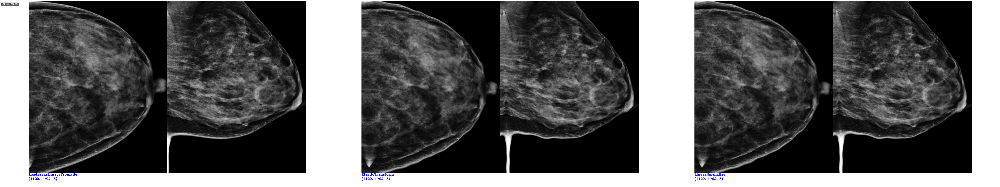

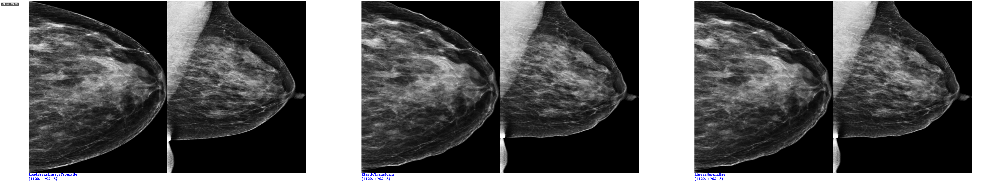

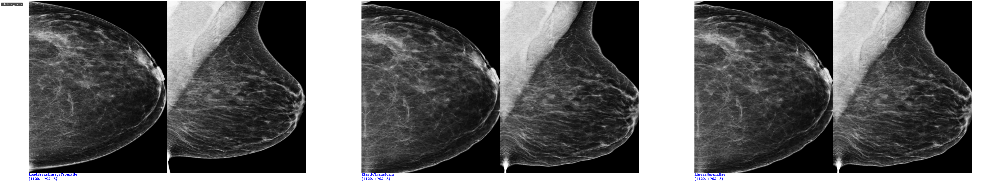

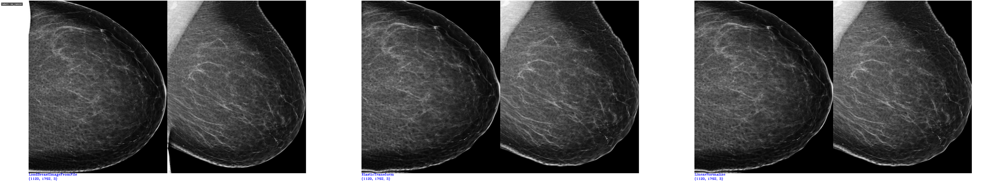

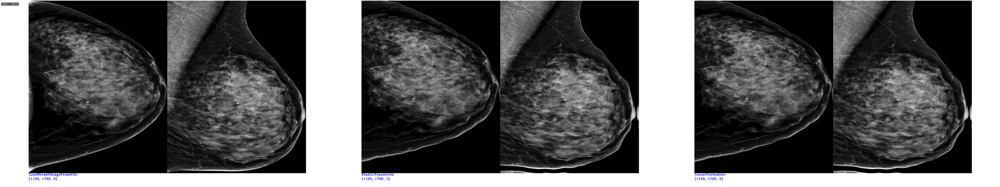

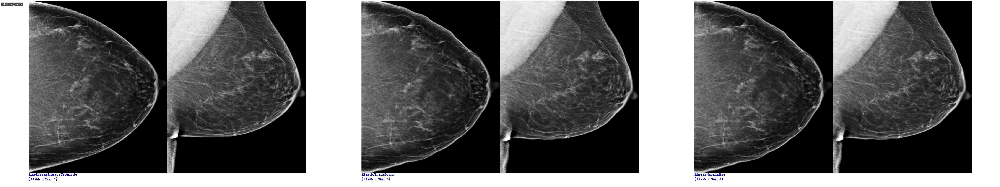

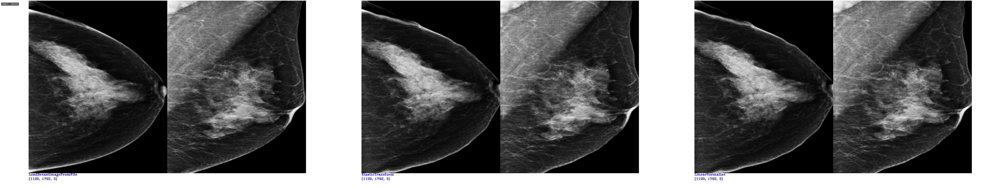

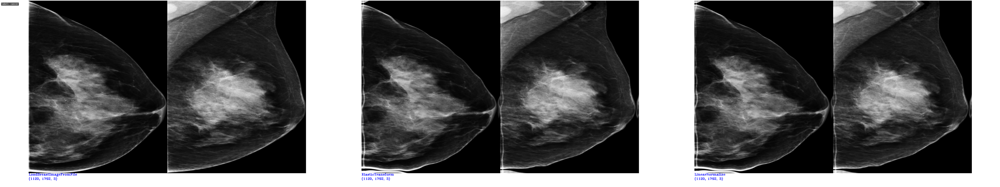

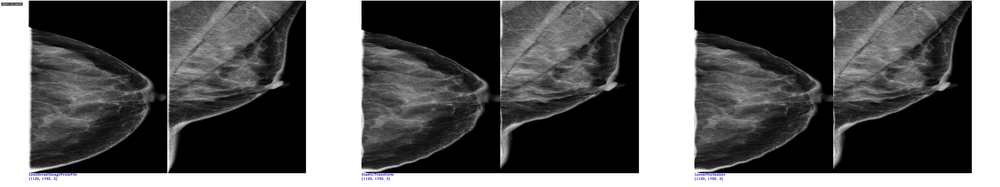

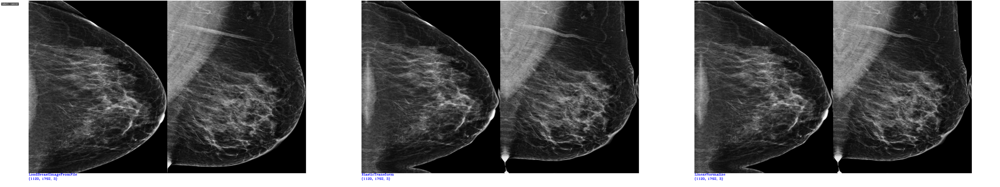

In [10]:
wind_w, wind_h = args.window_size.split('*')
wind_w, wind_h = int(wind_w), int(wind_h)  # showing windows size
# wind_w, wind_h = int(wind_w), int(wind_h)  # showing windows size
cfg = retrieve_data_cfg(args.config, args.skip_type, args.cfg_options,
                        args.phase)

dataset, pipelines = build_dataset_pipelines(cfg, args.phase)
CLASSES = dataset.CLASSES
display_number = min(args.number, len(dataset))
progressBar = ProgressBar(display_number)

with vis.ImshowInfosContextManager(fig_size=(wind_w, wind_h)) as manager:
    for i, item in enumerate(itertools.islice(dataset, display_number)):
        image = get_display_img(args, item, pipelines)
        # dist_path is None as default, means not saving pictures
        dist_path = None
        if args.output_dir:
            # some datasets don't have filenames, such as cifar
            src_path = 'test_{}.jpg'.format(i)
            dist_path = os.path.join(args.output_dir, src_path)

        infos = dict(label=CLASSES[item['gt_label']])

        ret, _ = manager.put_img_infos(
            image,
            infos,
            font_size=20,
            out_file=dist_path,
            show=args.show,
            **args.show_options)

        progressBar.update()

        if ret == 1:
            print('\nMannualy interrupted.')
            break

In [ ]:
def inference_model(model, img):
    """Inference image(s) with the classifier.

    Args:
        model (nn.Module): The loaded classifier.
        img (str/ndarray): The image filename or loaded image.

    Returns:
        result (dict): The classification results that contains
            `class_name`, `pred_label` and `pred_score`.
    """
    cfg = model.cfg
    device = next(model.parameters()).device  # model device
    # build the data pipeline
    if isinstance(img, str):
        if cfg.data.test.pipeline[0]['type'] != 'LoadMMImageFromFile':
            cfg.data.test.pipeline.insert(0, dict(type='LoadMMImageFromFile'))
        data = dict(img_info=dict(filename=img), img_prefix=None)
    else:
        if cfg.data.test.pipeline[0]['type'] == 'LoadMMImageFromFile':
            cfg.data.test.pipeline.pop(0)
        data = dict(img=img)
    test_pipeline = Compose(cfg.data.test.pipeline)
    data = test_pipeline(data)
    data = collate([data], samples_per_gpu=1)
    if next(model.parameters()).is_cuda:
        # scatter to specified GPU
        data = scatter(data, [device])[0]

    # forward the model
    with torch.no_grad():
        scores = model(return_loss=False, **data)
        pred_score = np.max(scores, axis=1)[0]
        pred_label = np.argmax(scores, axis=1)[0]
        result = {'pred_label': pred_label, 'pred_score': float(pred_score)}
    result['pred_class'] = model.CLASSES[result['pred_label']]
    return result

In [ ]:
# build the model from a config file and a checkpoint file
model = init_model(config, checkpoint, device=device)
# test a single image
result = inference_model(model, img)
# show the results
print(mmcv.dump(result, file_format='json', indent=4))
show_result_pyplot(model, img, result)